In [1]:
!pip install mediapipe

import torch
import torchvision
from torchvision import  models, transforms
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.utils import draw_keypoints
from torchvision.io import read_image
import numpy as np
import pandas as pd
import mediapipe as mp
import cv2
import requests
from IPython.display import Image, display
import matplotlib.pyplot as plt
import sys
import contextlib
import io
import os

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 33.4 MB/s eta 0:00:00


2024-04-27 13:39:27.752328: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-27 13:39:27.752528: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-27 13:39:27.953998: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
@contextlib.contextmanager
def suppress_print():
    original_stdout = sys.stdout
    sys.stdout = io.StringIO()
    try:
        yield
    finally:
        sys.stdout = original_stdout

In [3]:
model = models.detection.keypointrcnn_resnet50_fpn(pretrained = True)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=KeypointRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=KeypointRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/keypointrcnn_resnet50_fpn_coco-fc266e95.pth" to /root/.cache/torch/hub/checkpoints/keypointrcnn_resnet50_fpn_coco-fc266e95.pth
100%|██████████| 226M/226M [00:04<00:00, 55.3MB/s]


In [4]:
model

KeypointRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(640, 672, 704, 736, 768, 800), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.

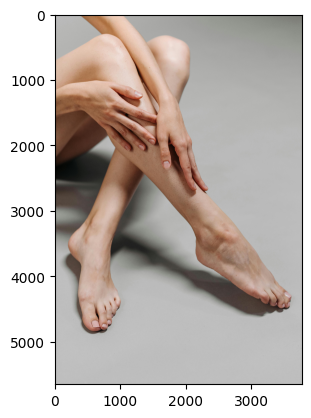

In [5]:
img = requests.get('https://images.pexels.com/photos/9486647/pexels-photo-9486647.jpeg')
# img = Image
with open('image.jpg', 'wb') as f:
    f.write(img.content)

image = read_image('image.jpg')
# image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image.permute(1,2,0))

plt.show()

In [6]:
transforms_img = models.detection.KeypointRCNN_ResNet50_FPN_Weights.COCO_LEGACY.transforms()
image_tensor = transforms_img(image)

print(image_tensor.shape)
with torch.no_grad():
    model.eval()
    op = model.forward(torch.unsqueeze(image_tensor, 0))

torch.Size([3, 5652, 3773])


In [7]:
op[0]['boxes']

tensor([[   0.0000,  127.3958, 3671.3257, 5236.9053],
        [  39.1120,   63.2090, 2352.5825, 3348.1157],
        [  51.5591,  624.5196, 1866.2395, 2684.7659],
        [  27.5691, 1002.5139, 1278.2020, 2321.3076],
        [  36.6439,   24.1471, 1966.4071, 1812.9633],
        [   0.0000, 1295.2581, 3218.7051, 3985.3982],
        [ 152.3938, 1184.8179,  850.6259, 2462.6387]])

In [8]:
key_points = op[0]['keypoints']
scores = op[0]['scores']

idx = torch.where(scores > 0.75)

# key_points.shape
key_points = key_points[idx]
print(key_points.shape)

torch.Size([2, 17, 3])


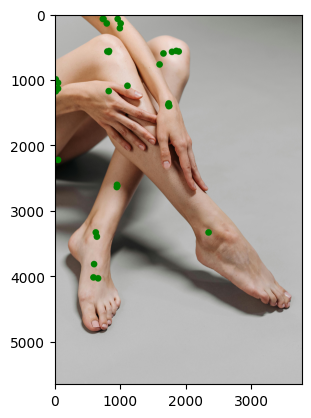

<Figure size 1000x600 with 0 Axes>

In [9]:
%matplotlib inline

image_labeled = draw_keypoints(image, key_points, colors='green', radius = 50)
plt.imshow(image_labeled.permute(1,2,0))
plt.figure(figsize=(10, 6))
plt.show()

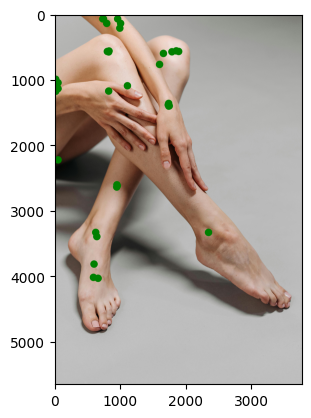

<Figure size 1000x600 with 0 Axes>

In [10]:
def detect_and_show_keypoint(img_path):
    image = None
    try:
        res = requests.get(img_path)
        if res.status_code == 200:
            with(open('downLoadedImg.jpg', 'wb')) as f:
                f.write(res.content)
        
        img_path = 'downLoadedImg.jpg'
    finally:
        image = read_image(img_path)
        image_tensor = transforms_img(image)
        
        with torch.no_grad():
            model.eval()
            op = model.forward(torch.unsqueeze(image_tensor, 0))
            
        key_points = op[0]['keypoints']
        scores = op[0]['scores']

        idx = torch.where(scores > 0.75)

        # key_points.shape
        key_points = key_points[idx]
        radius = image.shape[1]/100
        image_labeled = draw_keypoints(image, key_points, colors='green', radius = radius)
        plt.imshow(image_labeled.permute(1,2,0))
        plt.figure(figsize=(10, 6))
        plt.show()

detect_and_show_keypoint('https://images.pexels.com/photos/9486647/pexels-photo-9486647.jpeg') 

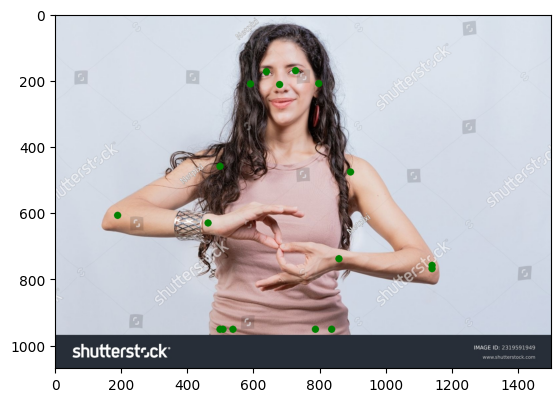

<Figure size 1000x600 with 0 Axes>

In [11]:
url = 'https://www.shutterstock.com/shutterstock/photos/2319591949/display_1500/stock-photo-people-speaking-in-sign-language-isolated-young-woman-gesturing-in-sign-language-lating-girl-2319591949.jpg'
detect_and_show_keypoint(url)

INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


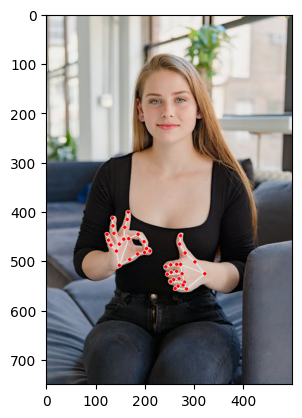

In [12]:
image_path = '/kaggle/working/downLoadedImg.jpg'

# Initialize drawing and hand/face landmark  detection solutions
mp_drawing = mp.solutions.drawing_utils
mp_hands = mp.solutions.hands
mp_face_mesh = mp.solutions.face_mesh


def fingerKeypoints(img_path, show = True):
    image = None
    try:
        res = requests.get(img_path)
        if res.status_code == 200:
            with(open('downLoadedImg.jpg', 'wb')) as f:
                f.write(res.content)
        
        img_path = 'downLoadedImg.jpg'
    finally:
        image = cv2.imread(img_path)
        # Convert the image to RGB format (MediaPipe expects RGB)
        rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Create hand and face landmark detection objects
        with mp_hands.Hands(min_detection_confidence=0.2, min_tracking_confidence=0.3) as hands:

            # Detect hands and faces in the image
            results = hands.process(rgb_image)
#             face_results = face.process(rgb_image)

            # Draw hand landmarks
            if results.multi_hand_landmarks:
                for hand_landmarks in results.multi_hand_landmarks:
                    mp_drawing.draw_landmarks(image, hand_landmarks, mp_hands.HAND_CONNECTIONS)
                    
#             # Draw face landmarks (if a face is detected)  
#             if face_results.multi_face_landmarks:
#                 face_landmarks = face_results.multi_face_landmarks[0]
#                 mp_drawing.draw_landmarks(image, face_landmarks, mp_face_mesh.FACEMESH_TESSELATION)
        
        
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        if show:
            plt.imshow(image)
            plt.show()
        return image
    
annotated_image_mp_fingKey = fingerKeypoints('https://images.pexels.com/photos/10029312/pexels-photo-10029312.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1')

In [13]:
!wget -O pose_landmarker.task -q 'https://storage.googleapis.com/mediapipe-models/pose_landmarker/pose_landmarker_heavy/float16/1/pose_landmarker_heavy.task'

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


In [14]:
from mediapipe.framework.formats import landmark_pb2
from mediapipe import solutions

def draw_landmarks_on_image(rgb_image, detection_result):
    pose_landmarks_list = detection_result.pose_landmarks
    annotated_image = np.copy(rgb_image)

    # Loop through the detected poses to visualize.
    for idx in range(len(pose_landmarks_list)):
        pose_landmarks = pose_landmarks_list[idx]

        # Draw the pose landmarks.
        pose_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
        pose_landmarks_proto.landmark.extend([
          landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in pose_landmarks
        ])
        
        solutions.drawing_utils.draw_landmarks(
          annotated_image,
          pose_landmarks_proto,
          solutions.pose.POSE_CONNECTIONS,
          solutions.drawing_styles.get_default_pose_landmarks_style())
        
    return annotated_image

I0000 00:00:1714225217.605229      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


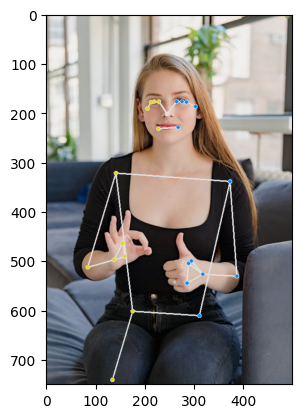

In [15]:
import warnings

hand_detector_path = '/kaggle/working/pose_landmarker.task'
image_path = '/kaggle/working/downLoadedImg.jpg'

import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision


def poseKeyPoints(image_path, show = True):
    #Base connection
    warnings.filterwarnings("ignore", category=UserWarning, module="mediapipe")
    with suppress_print():
        base_options = python.BaseOptions(model_asset_path='pose_landmarker.task',delegate=python.BaseOptions.Delegate.CPU)


        options = vision.PoseLandmarkerOptions(
            base_options=base_options,
            output_segmentation_masks=True,
        )

        detector = vision.PoseLandmarker.create_from_options(options)
    
        # Load the input image.
        image = mp.Image.create_from_file(image_path)

        # Detect pose landmarks from the input image.
        detection_result = detector.detect(image)

        # Process the detection result. In this case, visualize it.
        annotated_image = draw_landmarks_on_image(image.numpy_view(), detection_result)
    
    
    if show:
        plt.imshow(annotated_image)
    
    return annotated_image

annotated_image_pose = poseKeyPoints(image_path)

In [16]:
print(1)


print(3)

1
3


In [17]:
%matplotlib inline
def draw_annoted_image(image_path):
    with suppress_print():
        annotated_image_mp_fingKey = fingerKeypoints(image_path, show=False)
        if(image_path[:4] == 'http'):
            image_path = '/kaggle/working/downLoadedImg.jpg'
        annotated_image_pose = poseKeyPoints(image_path, show = False)
    
    fig, (ax1, ax2) = plt.subplots(1,2, figsize=(15,8))

    ax1.imshow(annotated_image_mp_fingKey)
    ax1.set_title('MediaPipe Annotated Image for Finger Keypoints')

    ax2.imshow(annotated_image_pose)
    ax2.set_title('Mediapipe Annoted Image for Pose Keypoints')

    ax1.tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)
    ax2.tick_params(left = False, right = False , labelleft = False ,labelbottom = False, bottom = False)

    plt.show()

I0000 00:00:1714225218.982075      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


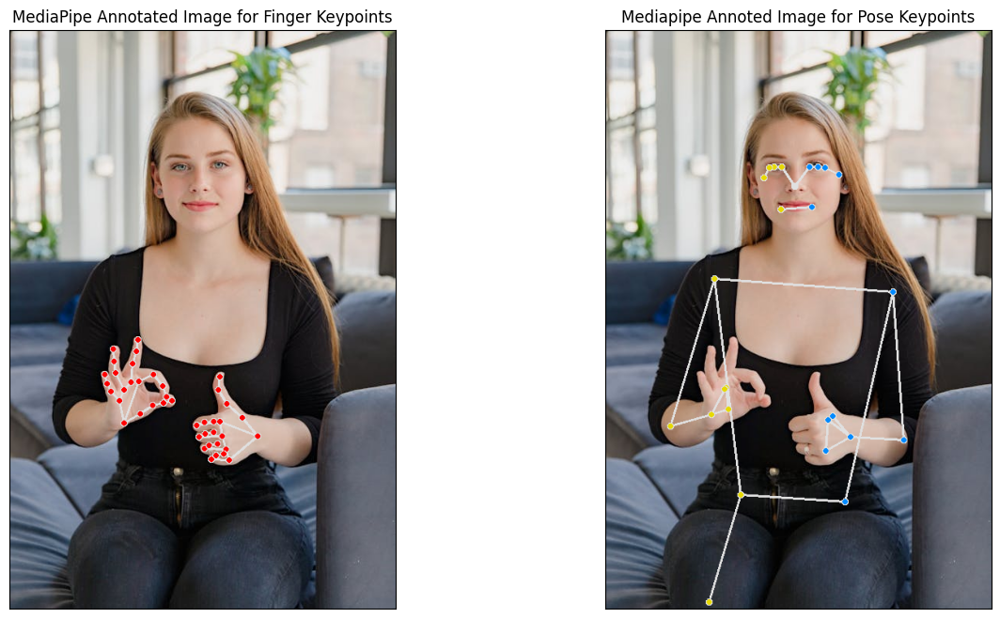

In [18]:
image_path = 'https://images.pexels.com/photos/10029312/pexels-photo-10029312.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1'
draw_annoted_image(image_path)

I0000 00:00:1714225220.719303      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


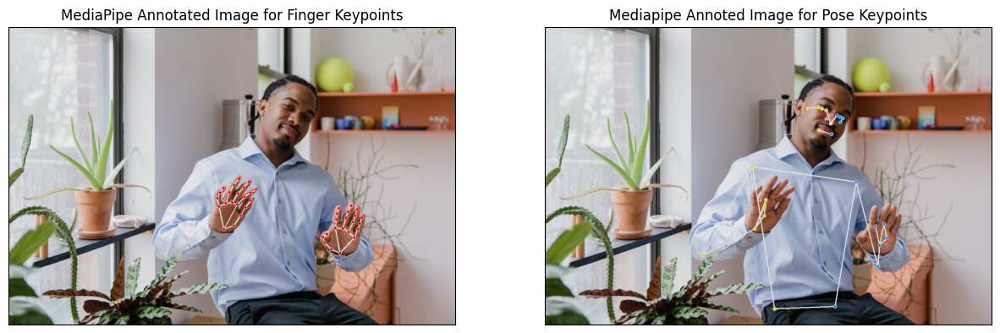

In [19]:
draw_annoted_image('https://images.pexels.com/photos/10031276/pexels-photo-10031276.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1')

In [20]:
import cv2

def extract_frames(video_path, output_folder):
    # Open the video file
    vidcap = cv2.VideoCapture(video_path)

    # Initialize frame counter
    count = 0

    # Read frames until no more frames are available
    success, image = vidcap.read()
    while success:
        # Save the frame as an image file (e.g., frame0.jpg, frame1.jpg, etc.)
        frame_filename = f"{output_folder}/frame{count}.jpg"
        cv2.imwrite(frame_filename, image)

        # Read the next frame
        success, image = vidcap.read()
        display(clear=True)
        print(f"Saving Frame : {count}")
        count += 1

    # Release the video capture object
    vidcap.release()

In [21]:
video_path = "/kaggle/input/include/Adjectives_1of8/Adjectives/1. loud/MVI_5177.MOV"
output_folder = "/kaggle/working/frames_output"
try:
    !mkdir /kaggle/working/frames_output
except:
    pass

extract_frames(video_path, output_folder)

Saving Frame : 55


I0000 00:00:1714225226.947745      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


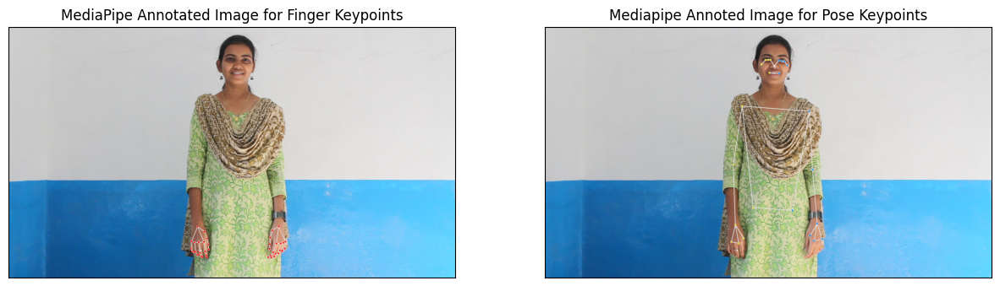

I0000 00:00:1714225228.743469      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


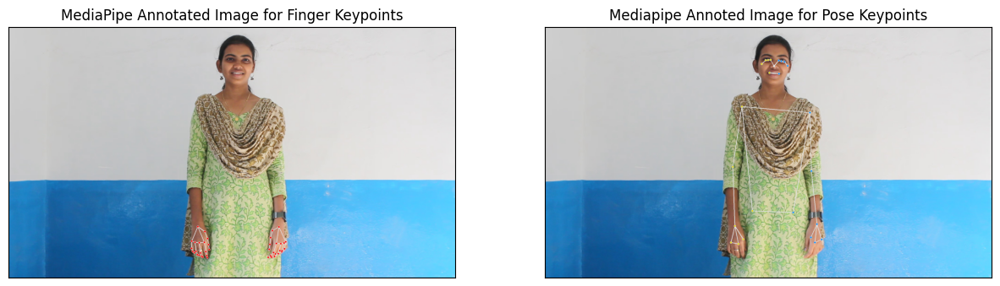

I0000 00:00:1714225230.480422      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


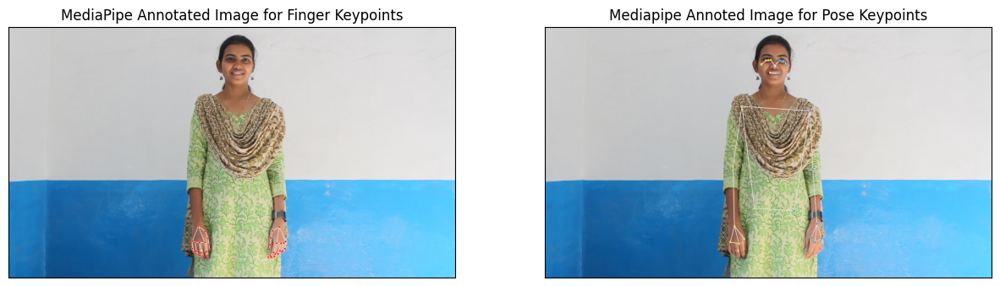

I0000 00:00:1714225232.247989      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


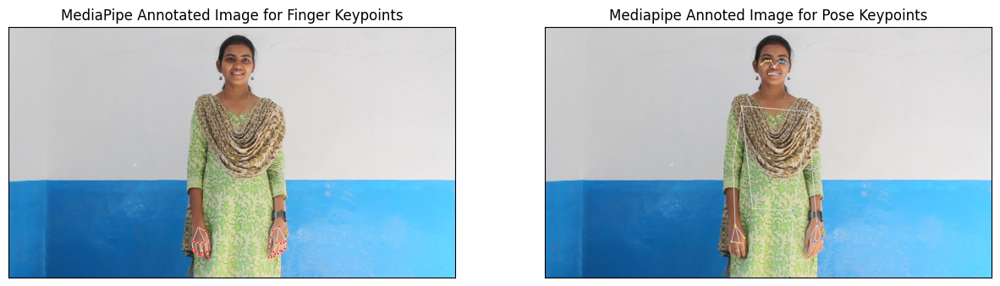

I0000 00:00:1714225233.997196      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


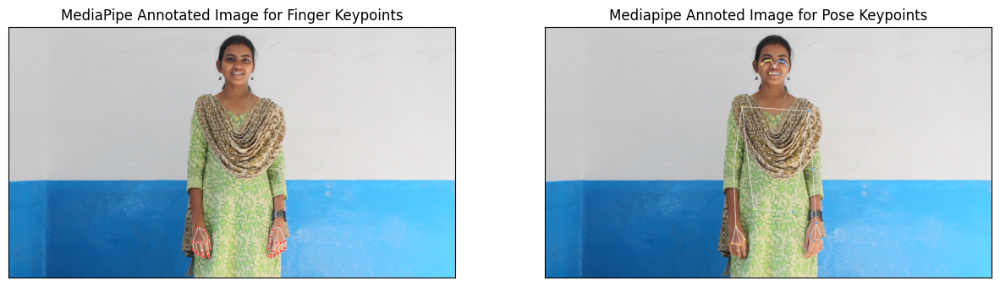

I0000 00:00:1714225235.675632      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


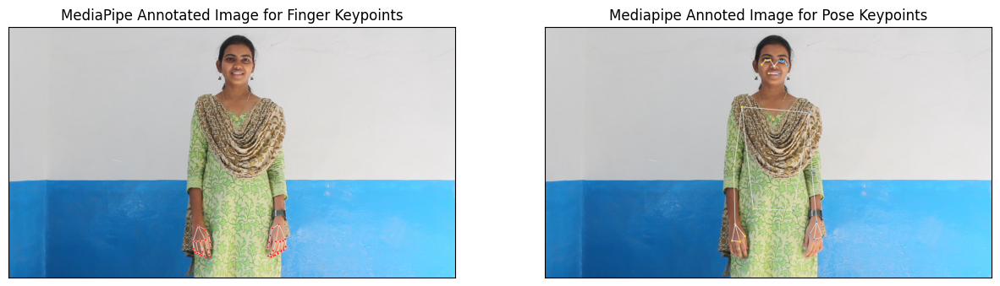

I0000 00:00:1714225237.454898      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


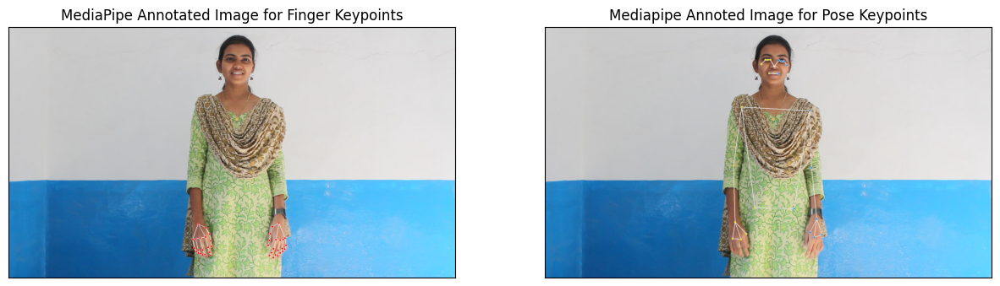

I0000 00:00:1714225239.151233      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


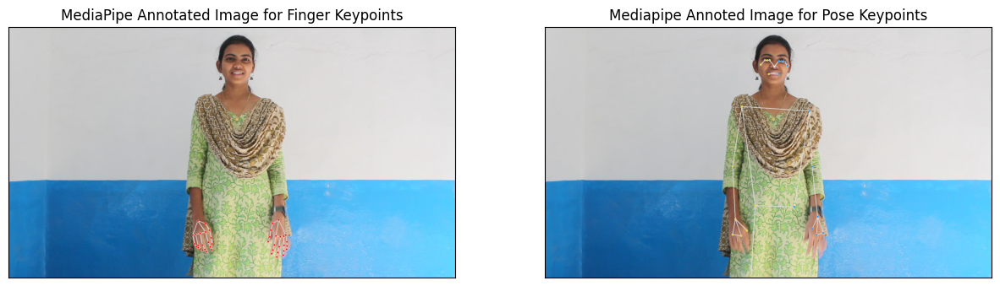

I0000 00:00:1714225240.815912      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


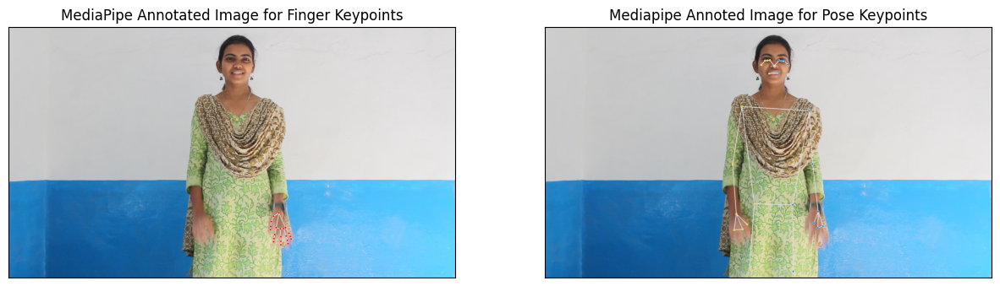

I0000 00:00:1714225242.474451      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


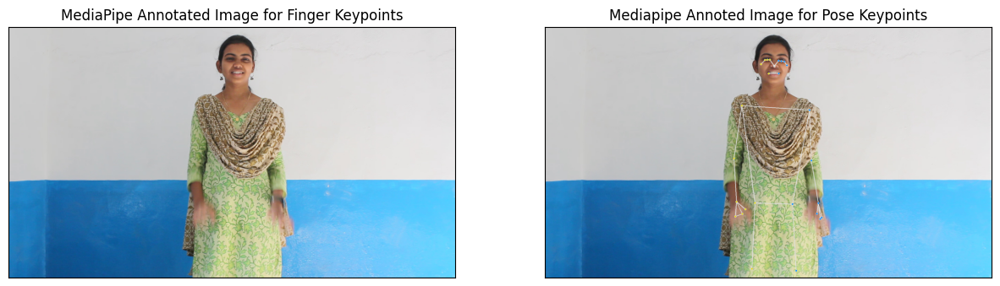

I0000 00:00:1714225244.176375      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


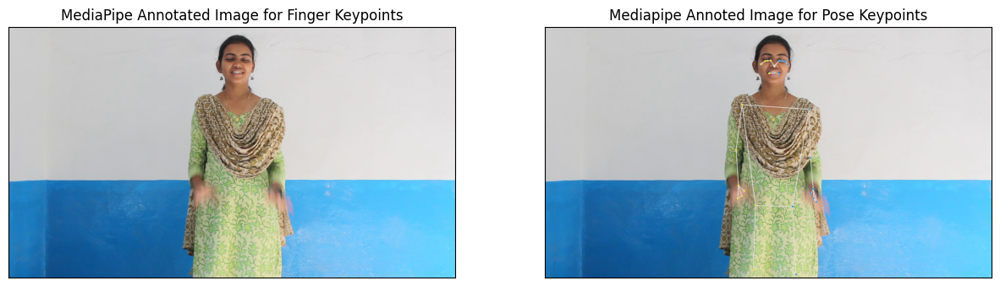

I0000 00:00:1714225246.275651      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


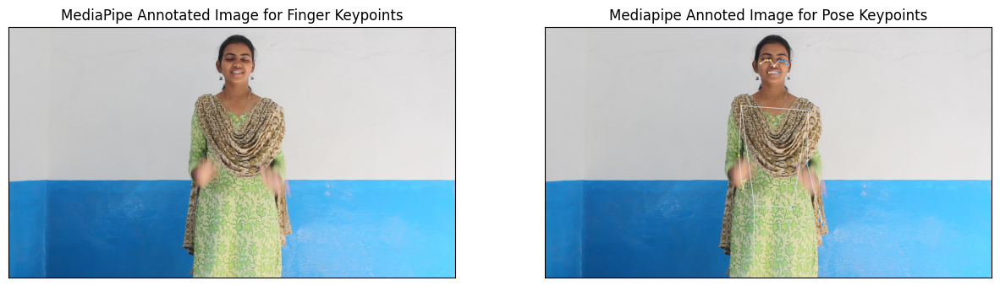

I0000 00:00:1714225247.994197      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


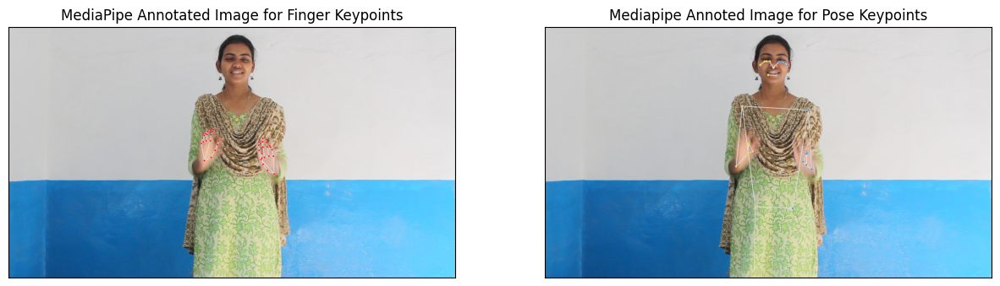

I0000 00:00:1714225249.776589      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


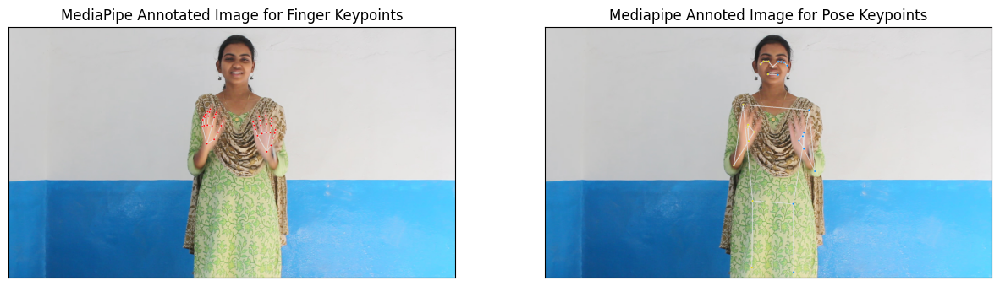

I0000 00:00:1714225251.442379      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


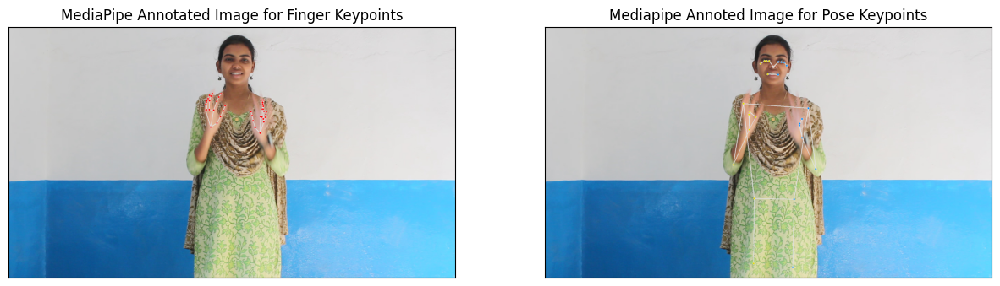

I0000 00:00:1714225253.171444      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


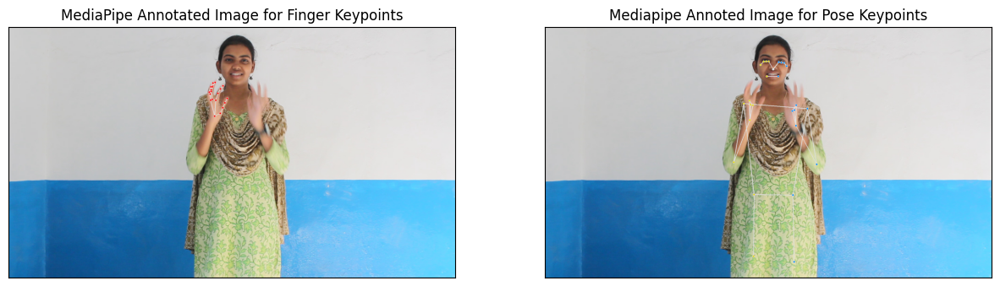

I0000 00:00:1714225254.830608      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


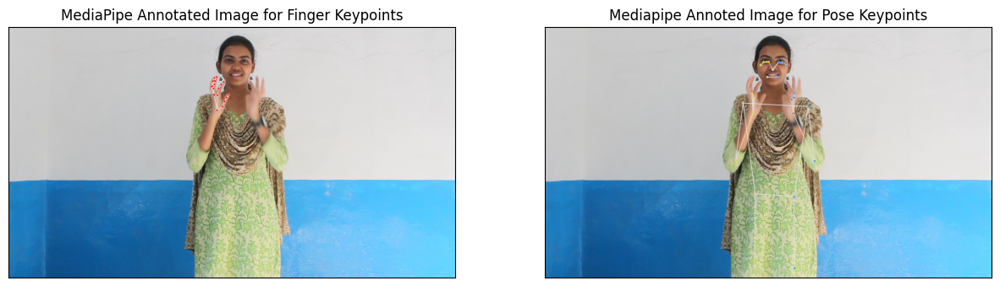

I0000 00:00:1714225256.567432      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


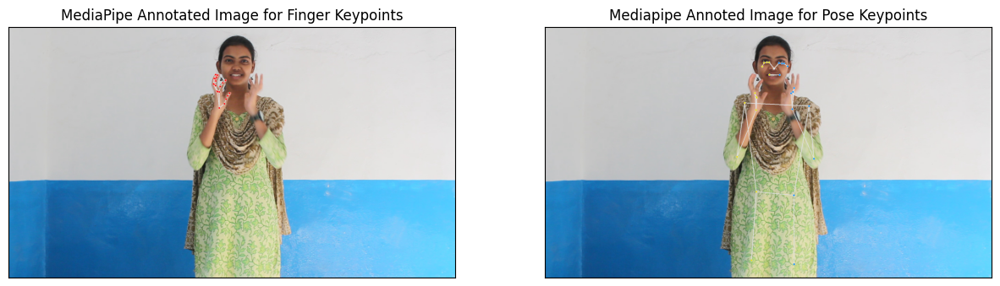

I0000 00:00:1714225258.301808      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


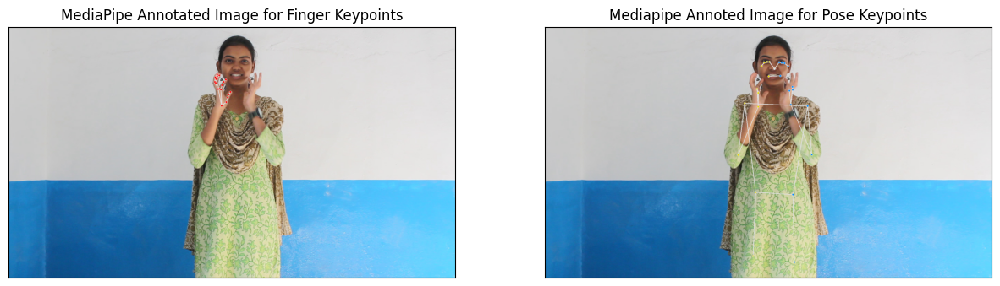

I0000 00:00:1714225260.048882      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


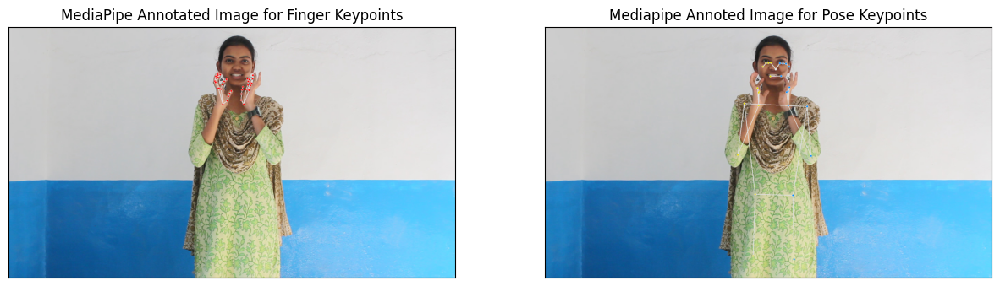

I0000 00:00:1714225261.727229      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


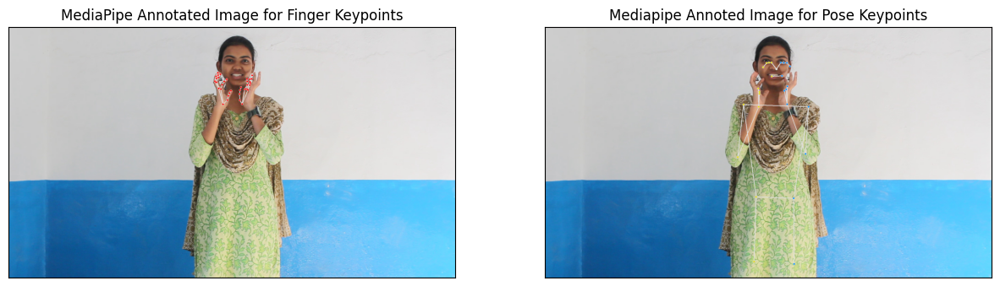

I0000 00:00:1714225263.409888      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


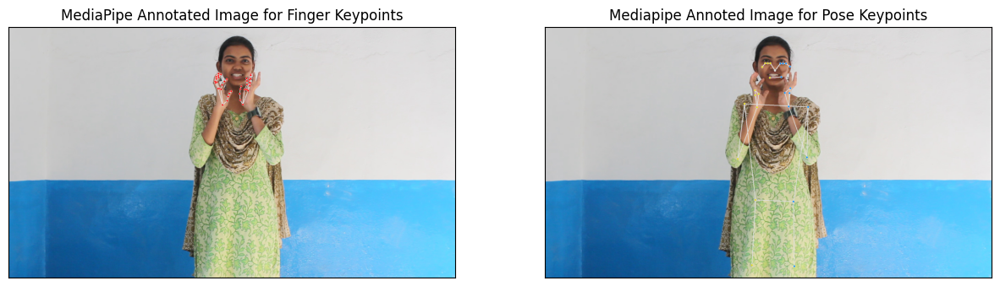

I0000 00:00:1714225265.086380      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


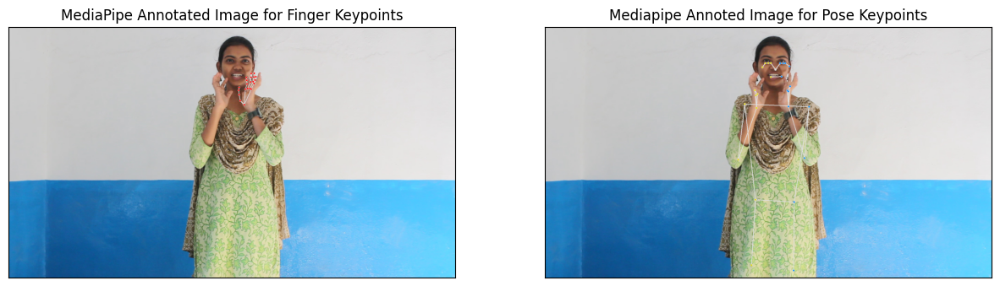

I0000 00:00:1714225266.782891      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


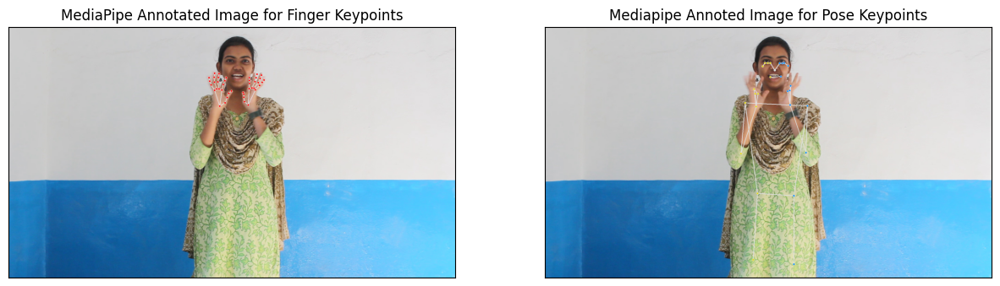

I0000 00:00:1714225268.522243      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


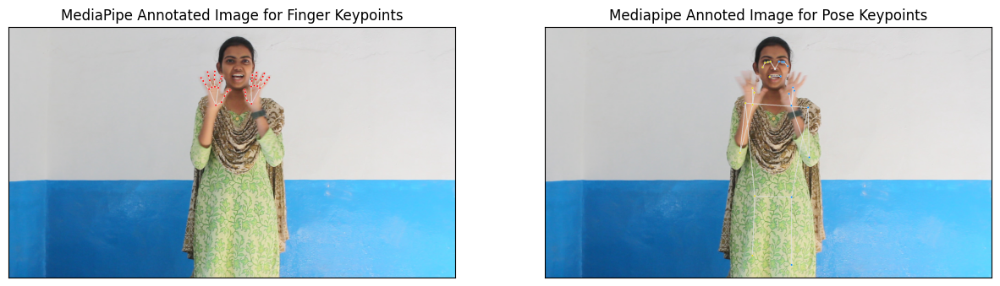

I0000 00:00:1714225270.288455      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


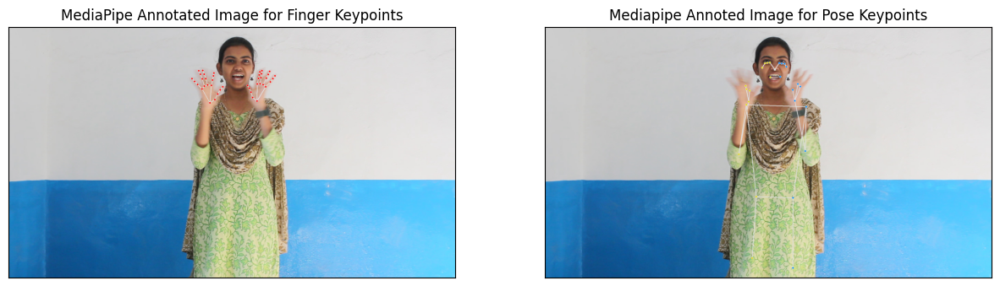

I0000 00:00:1714225272.028062      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


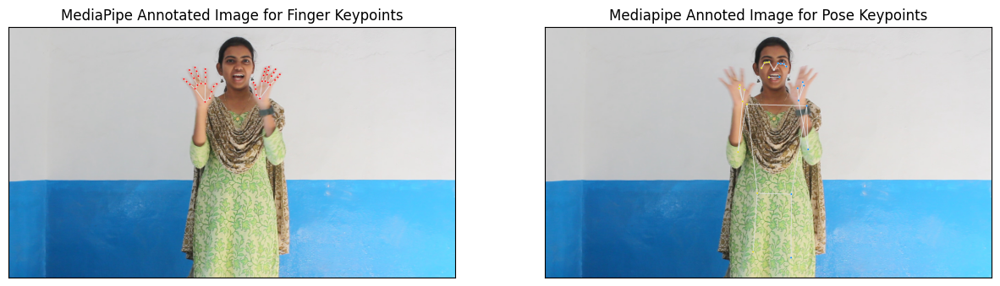

I0000 00:00:1714225273.768961      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


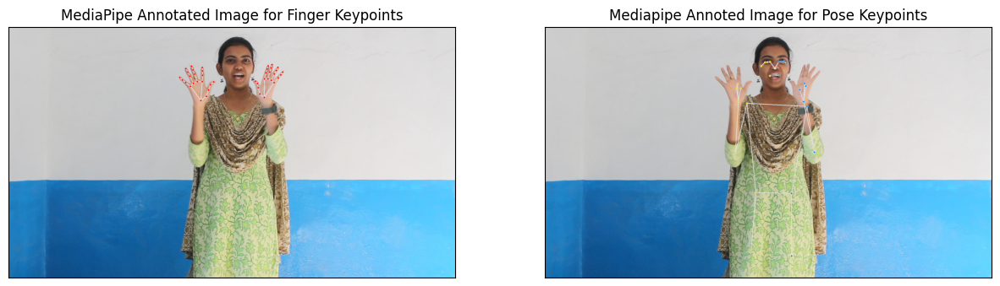

I0000 00:00:1714225275.483150      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


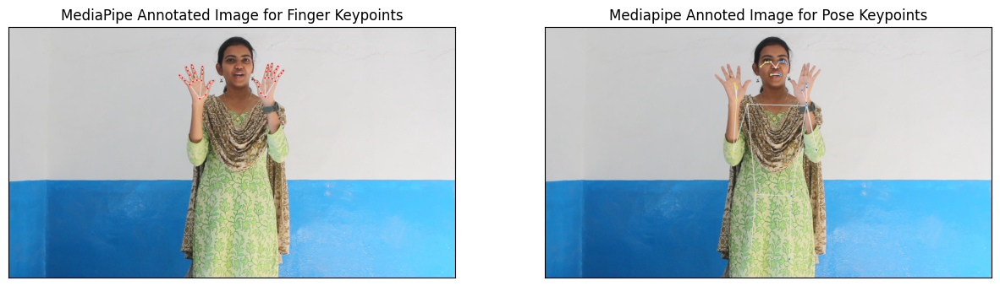

I0000 00:00:1714225277.155344      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


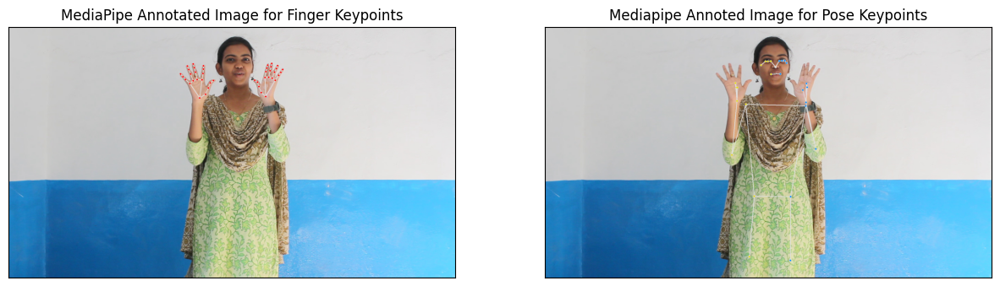

I0000 00:00:1714225278.888530      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


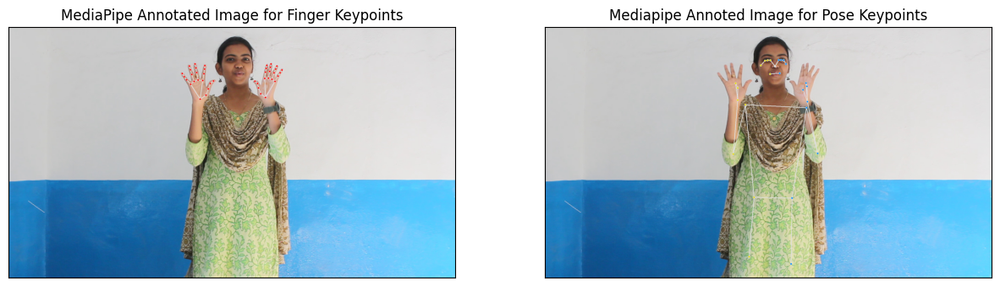

I0000 00:00:1714225280.582146      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


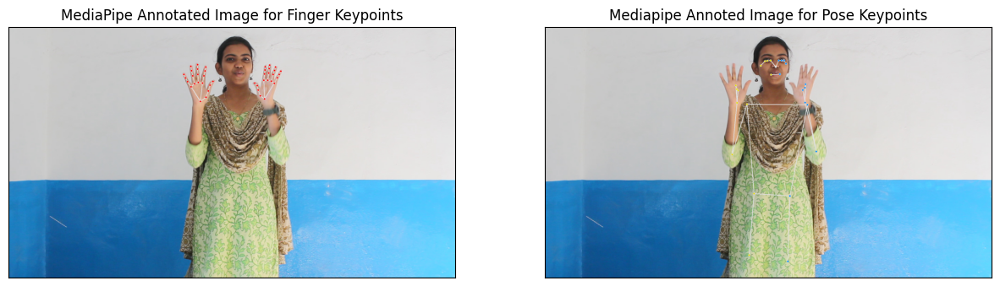

I0000 00:00:1714225282.319160      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


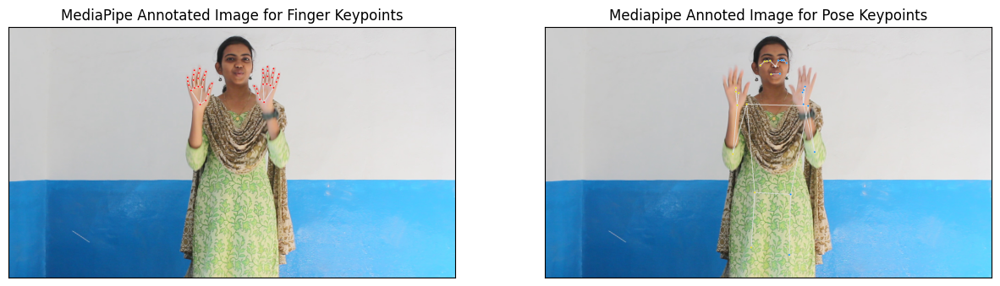

I0000 00:00:1714225284.042361      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


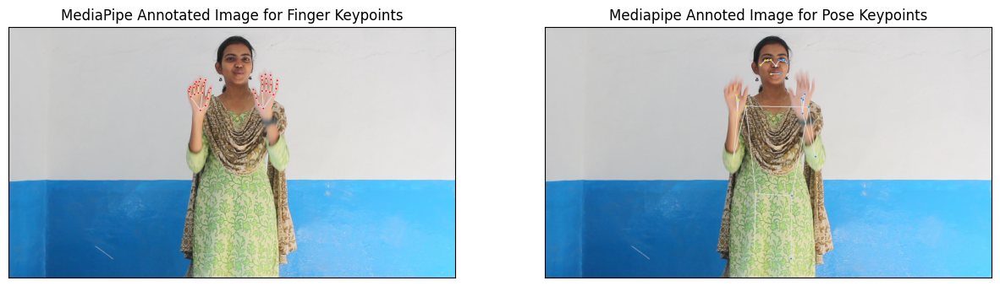

I0000 00:00:1714225285.766284      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


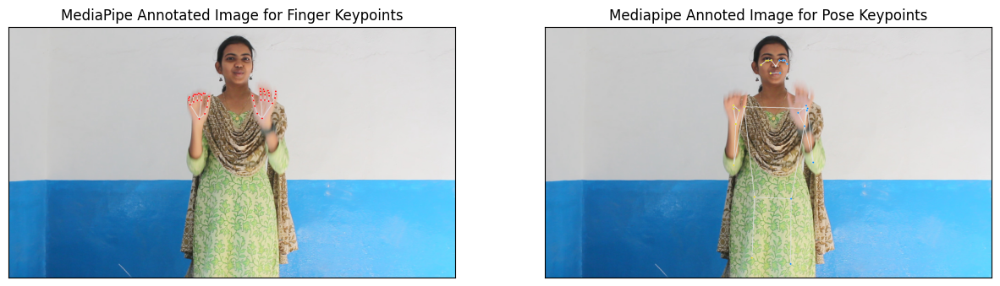

I0000 00:00:1714225287.506384      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


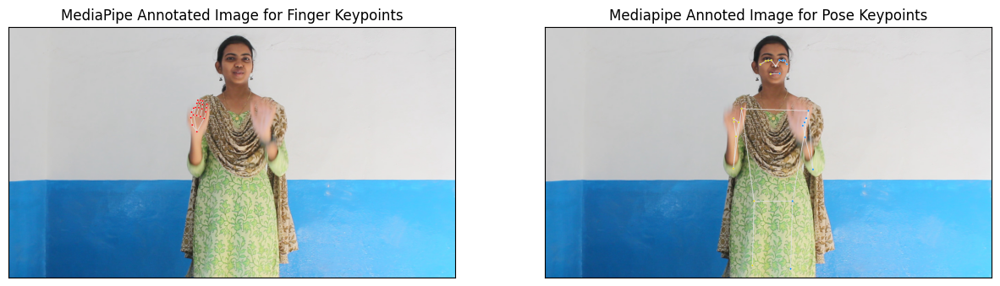

I0000 00:00:1714225289.778491      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


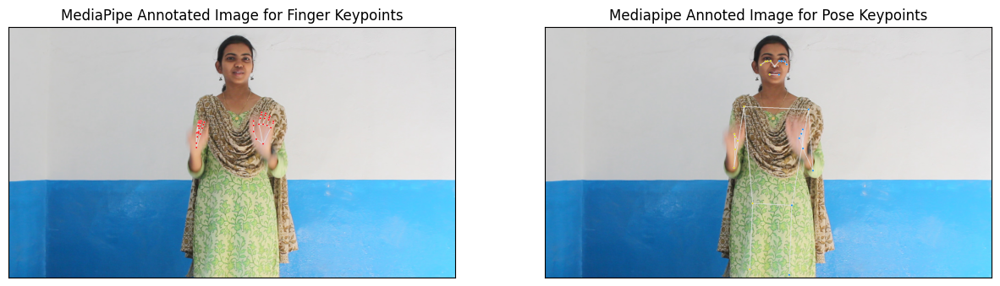

I0000 00:00:1714225291.481898      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


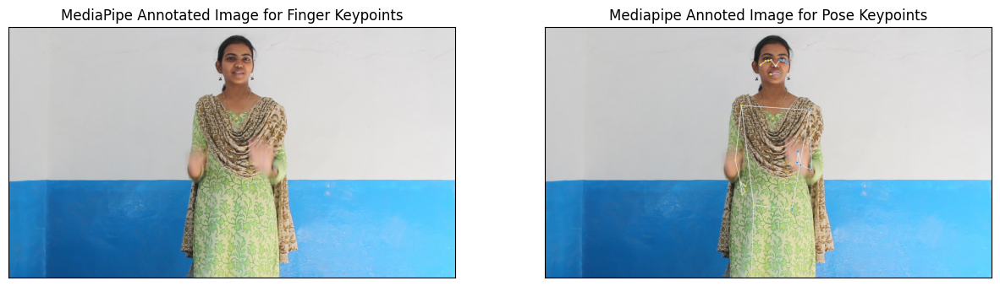

I0000 00:00:1714225293.187831      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


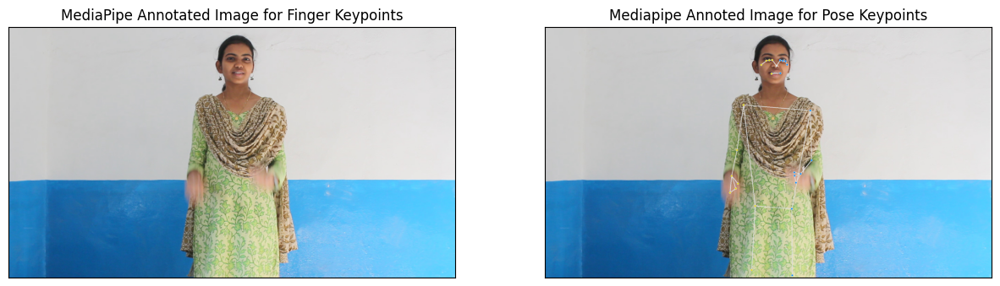

I0000 00:00:1714225294.926751      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


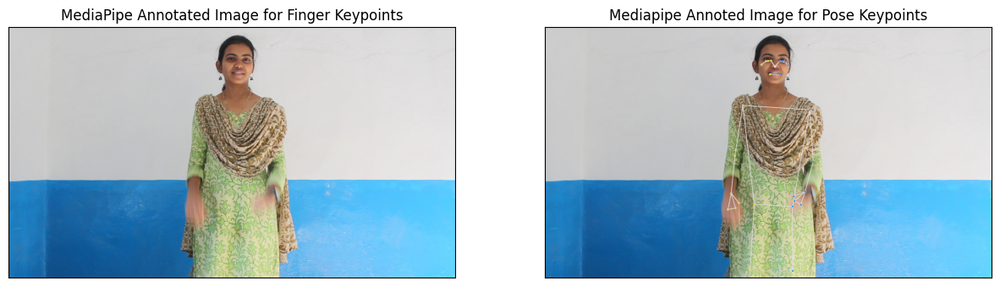

I0000 00:00:1714225296.659721      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


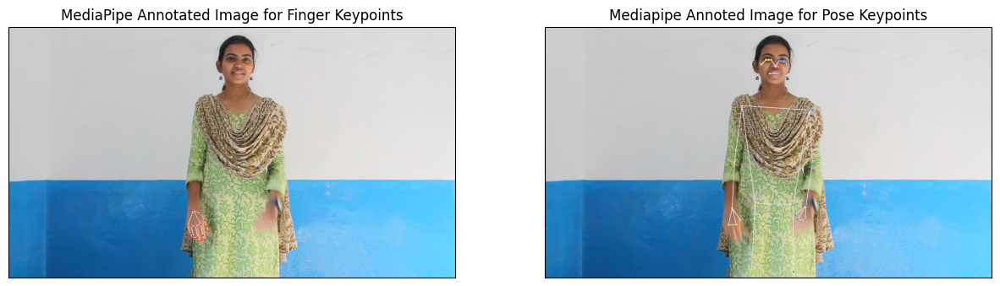

I0000 00:00:1714225298.318506      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


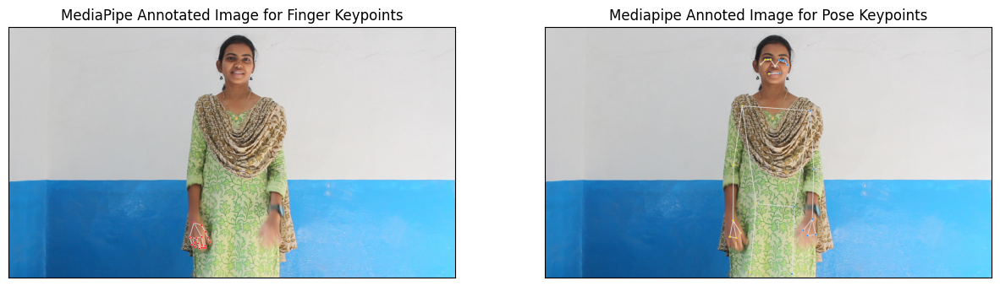

I0000 00:00:1714225300.138694      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


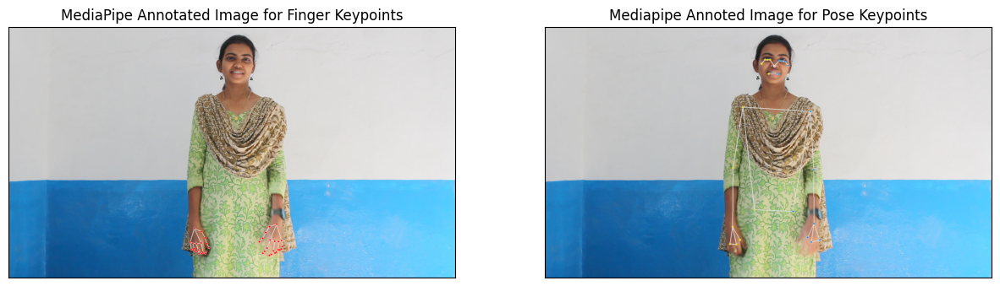

I0000 00:00:1714225301.833370      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


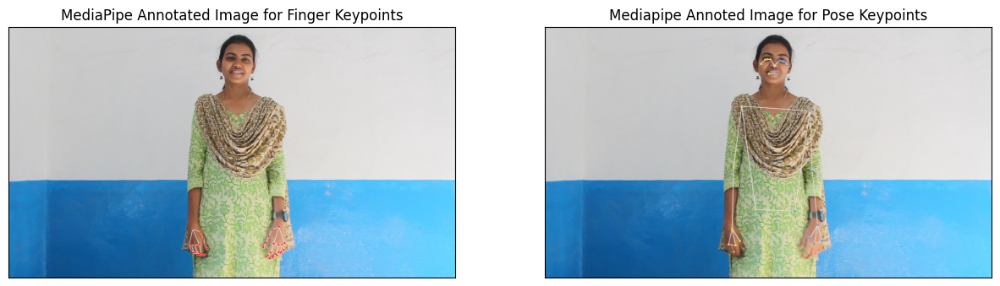

I0000 00:00:1714225303.572136      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


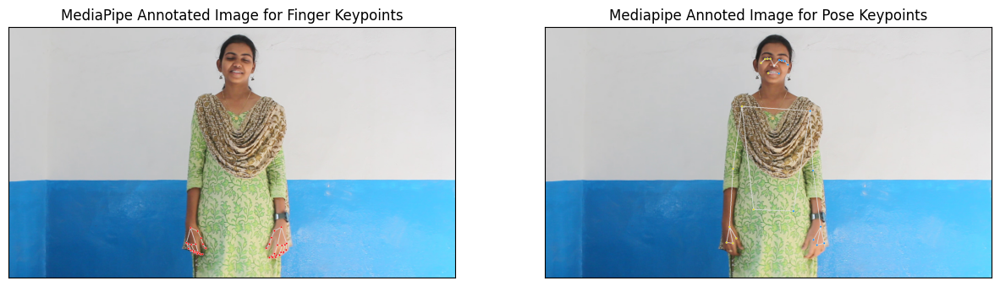

I0000 00:00:1714225305.241142      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


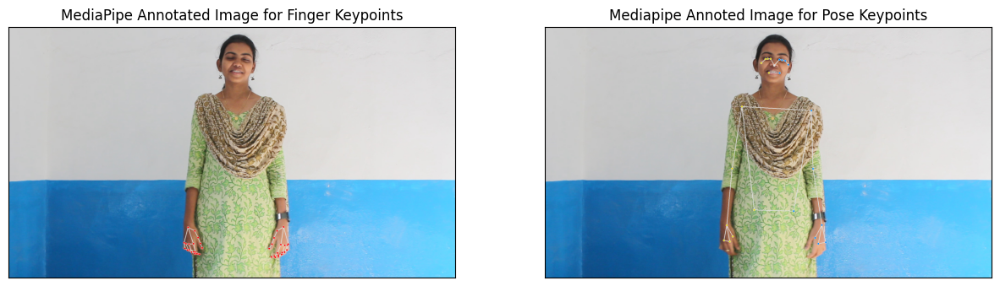

I0000 00:00:1714225306.910023      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


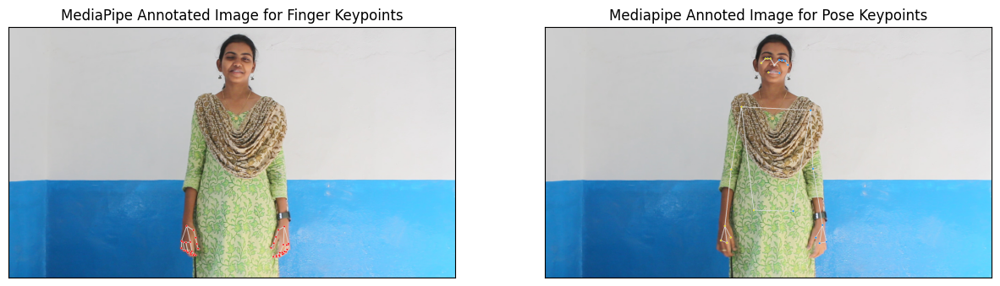

I0000 00:00:1714225308.579679      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


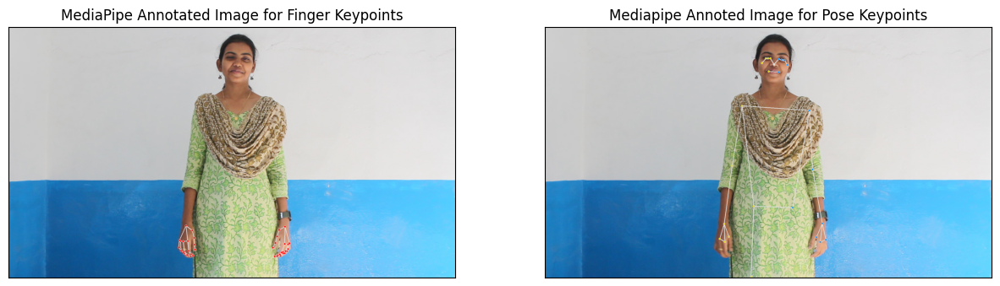

I0000 00:00:1714225310.303296      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


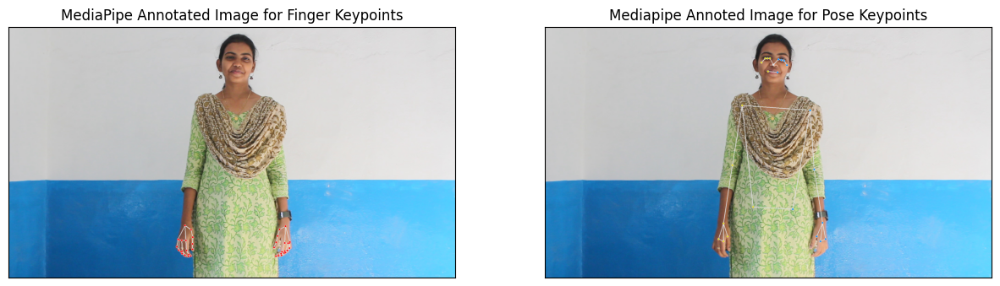

I0000 00:00:1714225312.050481      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


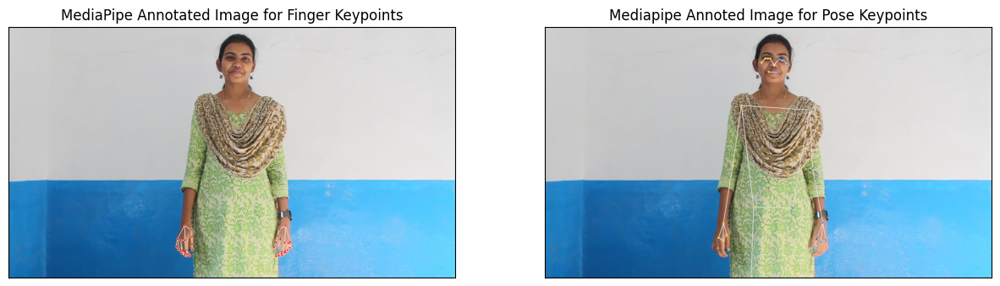

I0000 00:00:1714225313.740120      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


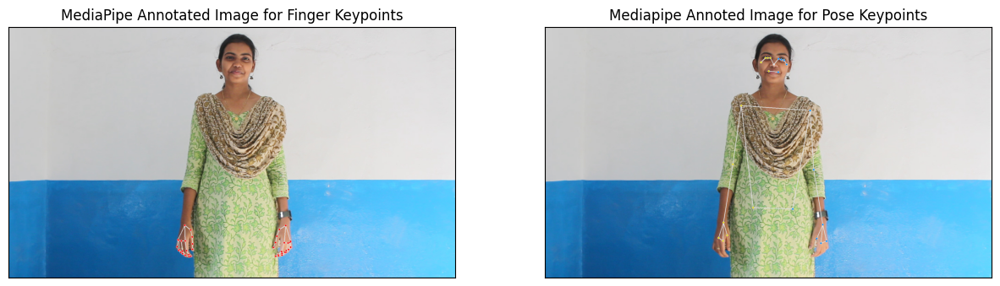

I0000 00:00:1714225315.477932      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


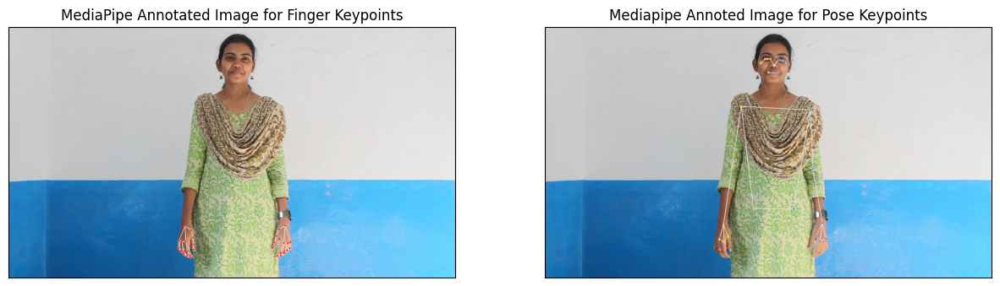

I0000 00:00:1714225317.226615      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


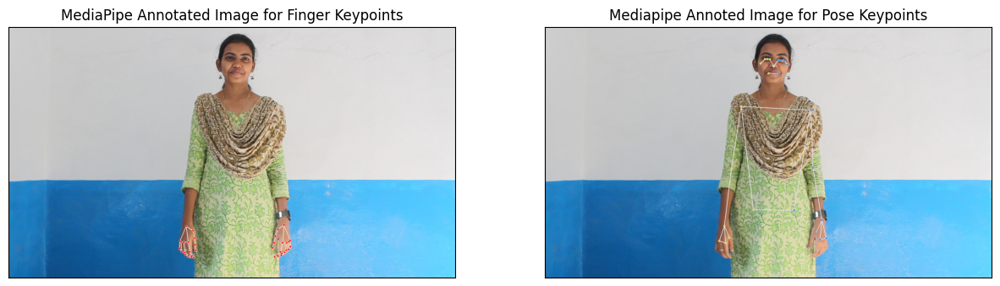

I0000 00:00:1714225318.918551      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


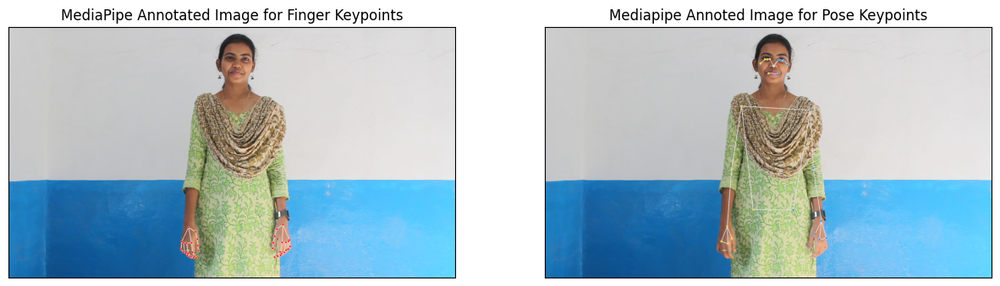

I0000 00:00:1714225320.696352      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


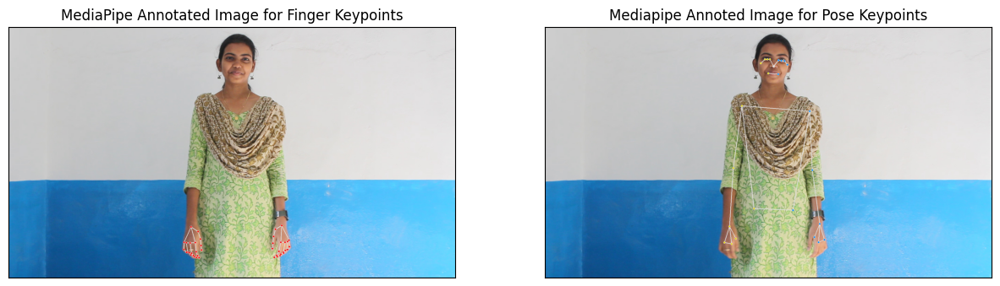

I0000 00:00:1714225322.437030      18 task_runner.cc:85] GPU suport is not available: INTERNAL: ; RET_CHECK failure (mediapipe/gpu/gl_context_egl.cc:77) display != EGL_NO_DISPLAYeglGetDisplay() returned error 0x300c


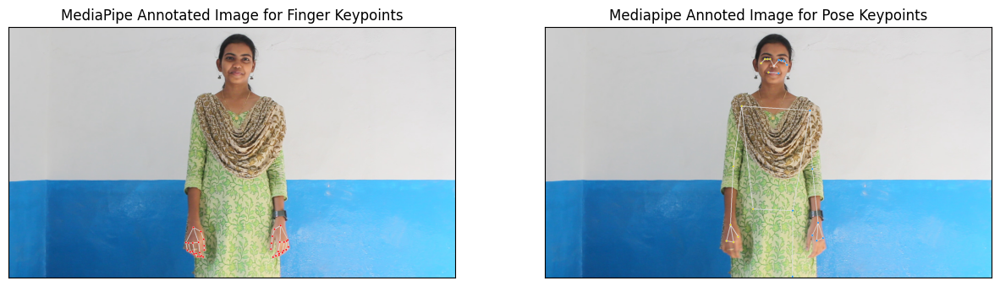

In [22]:
import glob
import re

def sorter(a):
    f = a.split('/')[-1]
    fn = int(re.search(r'\d+', f).group(0))
    return fn


frames = glob.glob('/kaggle/working/frames_output/*')
frames = sorted(frames, key = sorter)

# figure, axis = plt.subplots((len(frames)+2)//3, 3)
for idx, frame in enumerate(frames):
    draw_annoted_image(frame)
    